In [1]:
# import tensorflow as tf
import numpy as np
from numpy.linalg import norm
import pickle
import tqdm
import os
import random
import time
import math
# import tensorflow
# from tensorflow.keras.preprocessing import image
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
# from tensorflow.keras.models import Model

import warnings
warnings.filterwarnings("ignore")

DEBUGMODE = False
CALCULATE_FEATURE_VECTORS = False
CALCULATE_NEAREST_NEIGHBOURS = False
CALCULATE_TSNE = False

# physical_devices = tf.config.list_physical_devices('GPU')
# physical_devices

In [2]:
tf.config.experimental.set_memory_growth(physical_devices[0], True)

In [3]:
# preprocess_input = tensorflow.keras.applications.resnet.preprocess_input
input_shape = (224, 224, 3)
model = ResNet50(weights='imagenet',
                 include_top=False,
                 input_shape=input_shape,
                 pooling='max')

In [4]:
import matplotlib.pyplot as plt

def extract_features(img_path, model):
    img = image.load_img(img_path,
                         target_size=(input_shape[0], input_shape[1])
                        )
    img_array = image.img_to_array(img)
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array)
    features = model.predict(preprocessed_img)
    flattened_features = features.flatten()
    normalized_features = flattened_features / norm(flattened_features)
    return normalized_features

def extract_features_and_plot(img_path, model):
    img = image.load_img(img_path,
                         target_size=(input_shape[0], input_shape[1])
                        )
    img_array = image.img_to_array(img)
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array)
#     print("min-max", np.min(preprocessed_img[0]), np.max(preprocessed_img[0]))
#     print("plot min-max", np.min((preprocessed_img[0]+126.0)/280.0), np.max((preprocessed_img[0]+126.0)/280.0))
    plt.imshow((preprocessed_img[0]+126.0)/280.0, interpolation='lanczos')
    plt.show()
    features = model.predict(preprocessed_img)
    flattened_features = features.flatten()
    normalized_features = features / norm(flattened_features)
    return normalized_features

In [2]:
extensions = ['.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG']

def get_file_list(root_dir):
    file_list = []
    counter = 1
    for root, directories, filenames_baseline in os.walk(root_dir):
        for filename in filenames_baseline:
            if any(ext in filename for ext in extensions):
                file_list.append(os.path.join(root, filename))
                counter += 1
    return file_list

root_dir = 'E:/extended-clean'
print(len(get_file_list(root_dir)))

filenames = sorted(get_file_list(root_dir))

class_ids = []

for filename in filenames:
    artist_unique_id = filename.split('/')[-2].split('(')[-1][:-1]
    class_ids.append(artist_unique_id)

27175


In [3]:
features_pkl = '8T3WC.pickle'
filenames_pkl = 'GiH_u.pickle'

In [4]:
features_pkl_gen2 = 'features.pickle'
filenames_pkl_gen2 = 'filenames.pickle'

In [8]:
# DUMP

if CALCULATE_FEATURE_VECTORS:
    pickle.dump(feature_list, open(features_pkl, 'wb'))
    pickle.dump(filenames, open(filenames_pkl,'wb'))

In [5]:
import numpy as np
import pickle
from tqdm import tqdm, tqdm_notebook
import random
import time
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import PIL
from PIL import Image
from sklearn.neighbors import NearestNeighbors

import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [6]:
# LOAD

feature_list_baseline = pickle.load(open(features_pkl, 'rb'))
filenames_baseline = pickle.load(open(filenames_pkl, 'rb'))

In [7]:
feature_list_gen2 = pickle.load(open(features_pkl_gen2, 'rb'))
filenames_gen2 = pickle.load(open(filenames_pkl_gen2, 'rb'))

In [8]:
num_images = len(filenames_baseline)
num_features_per_image = len(feature_list_baseline[0])
print("Number of images = ", num_images)
print("Number of features per image = ", num_features_per_image)

Number of images =  27175
Number of features per image =  2048


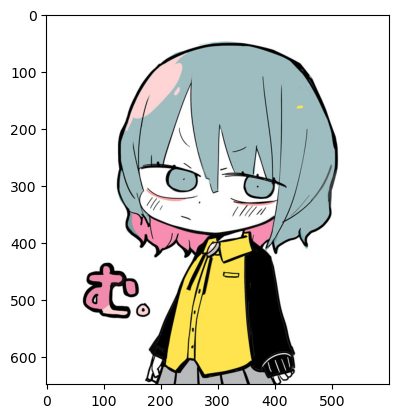

In [9]:
# Nearest Neighbours

neighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list_baseline)

random_index = 21226 #*253 # 4402
distances, indices = neighbors.kneighbors([feature_list_baseline[random_index]])
f_name = os.path.join("\\".join(root_dir.split('/')), *filenames_baseline[random_index].split('\\')[1:])
plt.imshow(mpimg.imread(f_name)) #, interpolation='lanczos')

In [10]:
def classname_filename(s: str):
    return s.split('\\')[-2] + '/' + s.split('\\')[-1]

# Plot the nearest images given a query image
def plot_images(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(20, 10))
    columns = 4
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) // columns + 1, columns, i + 1)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                         "\nDistance: " +
                         str(float("{0:.2f}".format(distances[i]))))
        plt.imshow(image)
        # Save the plot in high definition
        # plt.savefig('results/' + str(random.randint(0,10000))+'.jpg', format='jpg', dpi=200)

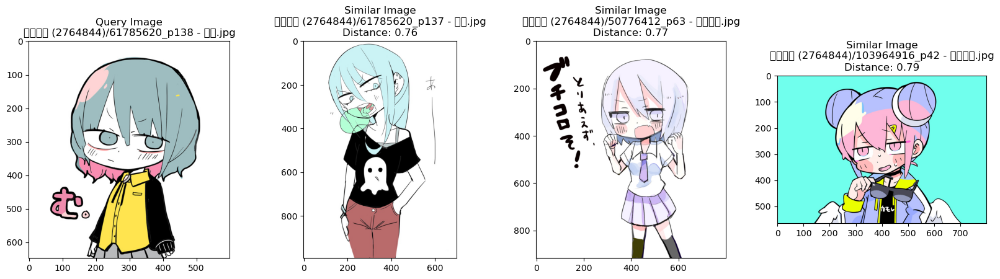

In [11]:
# Distances of the closest 5 images

similar_image_paths = [f_name] + \
                          [os.path.join("\\".join(root_dir.split('/')), *filenames_baseline[indices[0][i]].split('\\')[1:]) for i in range(1, 4)]
plot_images(similar_image_paths, distances[0])
plt.show()

14718


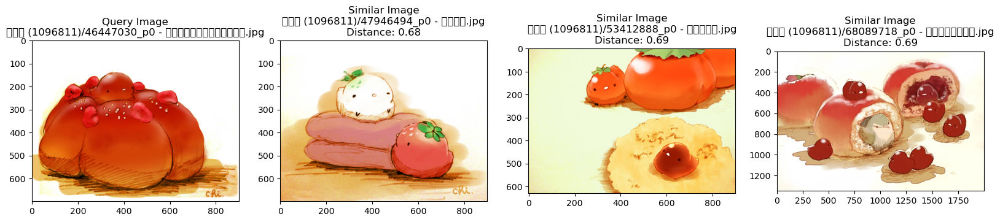

10932


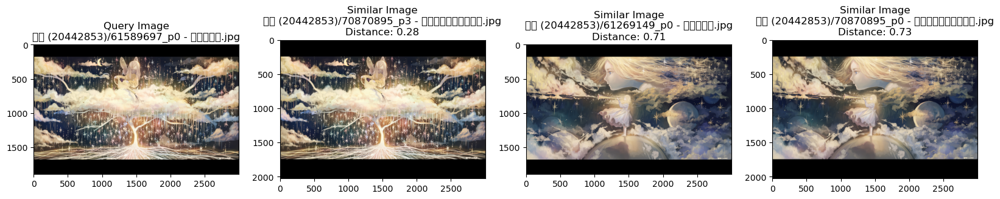

14941


KeyboardInterrupt: 

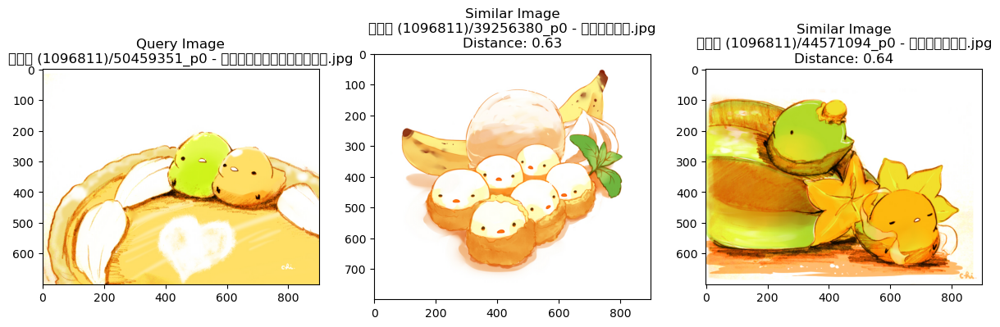

In [15]:
import warnings
warnings.filterwarnings("ignore")

if CALCULATE_NEAREST_NEIGHBOURS:
    for i in range(10):
        random_image_index = random.randint(0, num_images)
        print(random_image_index)
        distances, indices = neighbors.kneighbors(
            [feature_list_baseline[random_image_index]])
        # Don't take the first closest image as it will be the same image
        similar_image_paths = [filenames_baseline[random_image_index]] + [filenames_baseline[indices[0][i]] for i in range(1, 4)]
        plot_images(similar_image_paths, distances[0])
        plt.show()

In [15]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.cbook import get_sample_data
from tqdm.contrib import tzip, tenumerate

def plot_images_in_2d(x, y, image_paths, axis=None, zoom=1, dpi=400):
    if axis is None:
        axis = plt.gca()
    x, y = np.atleast_1d(x, y)
    
#     sequence = zip(x, y, image_paths)
    for x0, y0, image_path in tzip(x, y, image_paths):
#         x0, y0, image_path = sequence[i]
        image = Image.open(image_path)
        image.thumbnail((100, 100), Image.ANTIALIAS)
#         print(np.shape(image))
        if np.shape(image)[-1] < 3:
            continue
        img = OffsetImage(image, zoom=zoom)
        anno_box = AnnotationBbox(img, (x0, y0),
                                  xycoords='data',
                                  frameon=False)
        axis.add_artist(anno_box)
    axis.update_datalim(np.column_stack([x, y]))
    axis.autoscale()
    plt.savefig('results/cluster-' + str(random.randint(0,10000))+'.jpg', format='jpg')

def show_tsne(x, y, selected_filenames, zoom=.3, dpi=400):
    fig, axis = plt.subplots()
    fig.set_size_inches(22, 22, forward=True)
    plot_images_in_2d(x, y, selected_filenames, zoom=zoom, dpi=dpi, axis=axis)
    plt.show()

def tsne_to_grid_plotter_manual(x, y, selected_filenames, zoom=.58, dpi=400):
    S = 2000
    s = 100
    x = (x - min(x)) / (max(x) - min(x))
    y = (y - min(y)) / (max(y) - min(y))
    x_values = []
    y_values = []
    filename_plot = []
    x_y_dict = {}
    for i, image_path in tenumerate(selected_filenames):
        a = np.ceil(x[i] * (S - s))
        b = np.ceil(y[i] * (S - s))
        a = int(a - np.mod(a, s))
        b = int(b - np.mod(b, s))
        if str(a) + "|" + str(b) in x_y_dict:
            continue
        x_y_dict[str(a) + "|" + str(b)] = 1
        x_values.append(a)
        y_values.append(b)
        filename_plot.append(image_path)
    fig, axis = plt.subplots()
    fig.set_size_inches(22, 22, forward=True)
    plot_images_in_2d(x_values, y_values, filename_plot, zoom=zoom, dpi=dpi, axis=axis)
    plt.show()

In [20]:
pcaneighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list_compressed)

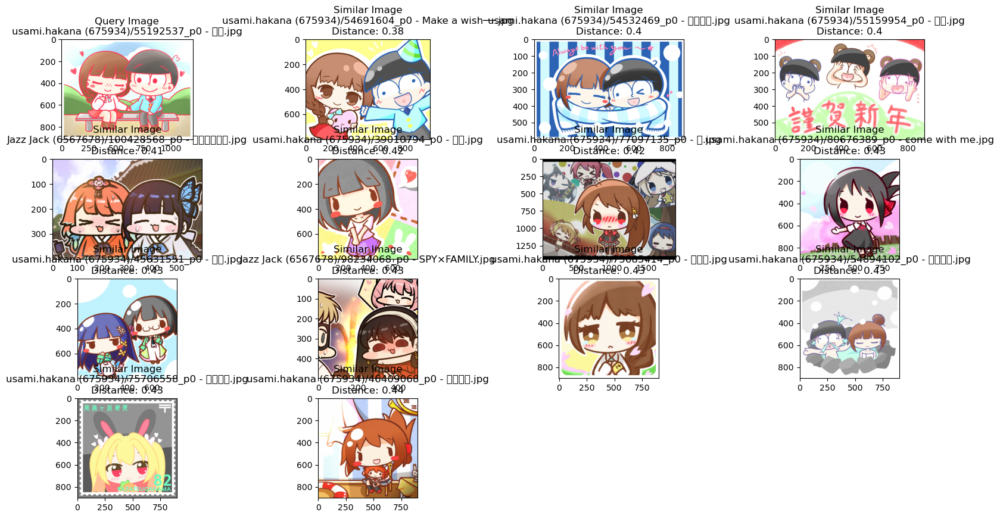

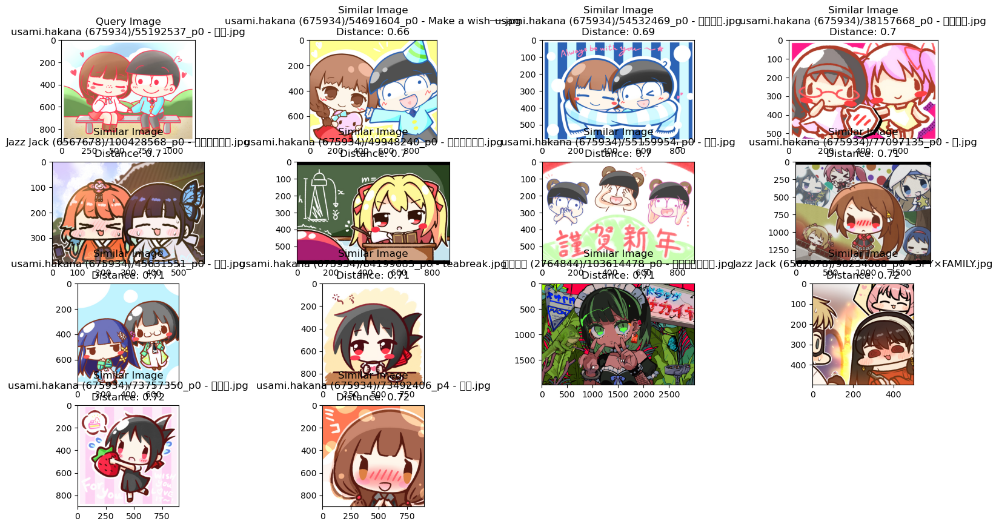

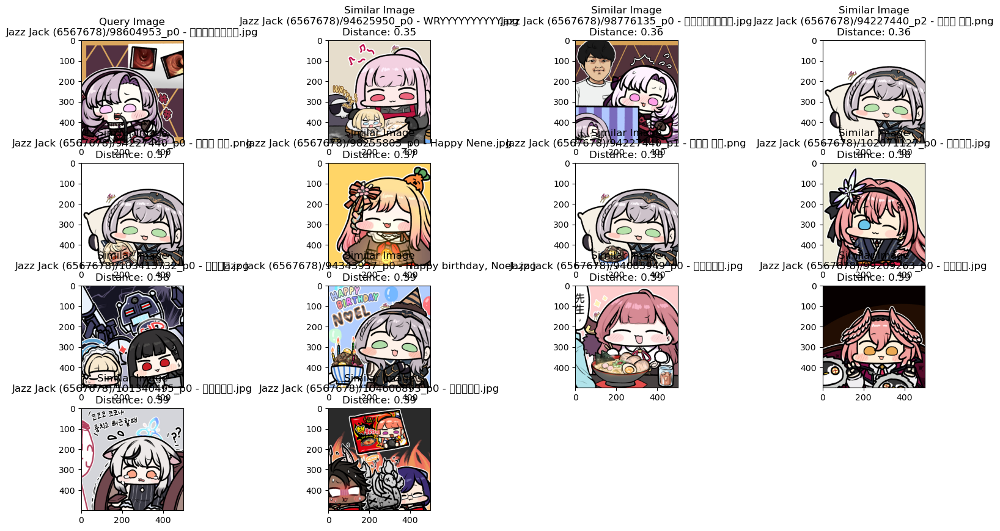

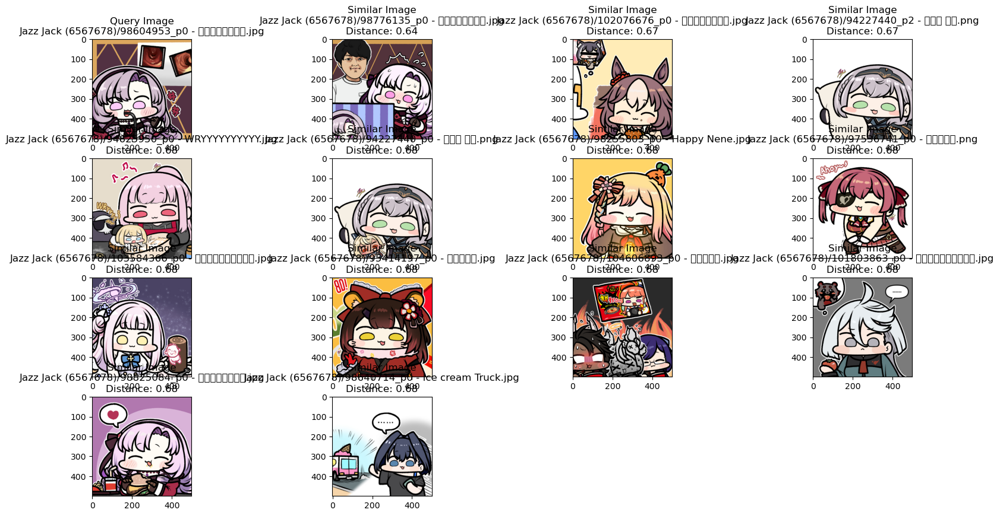

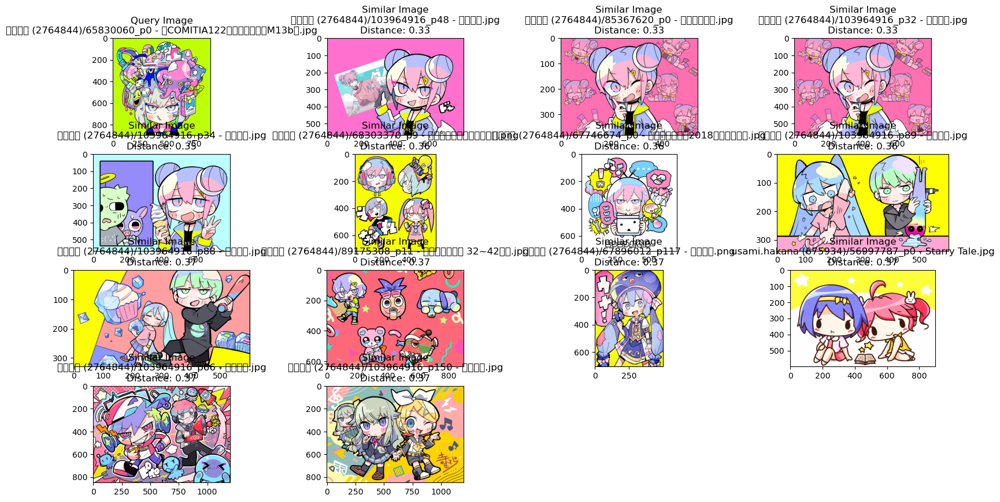

...

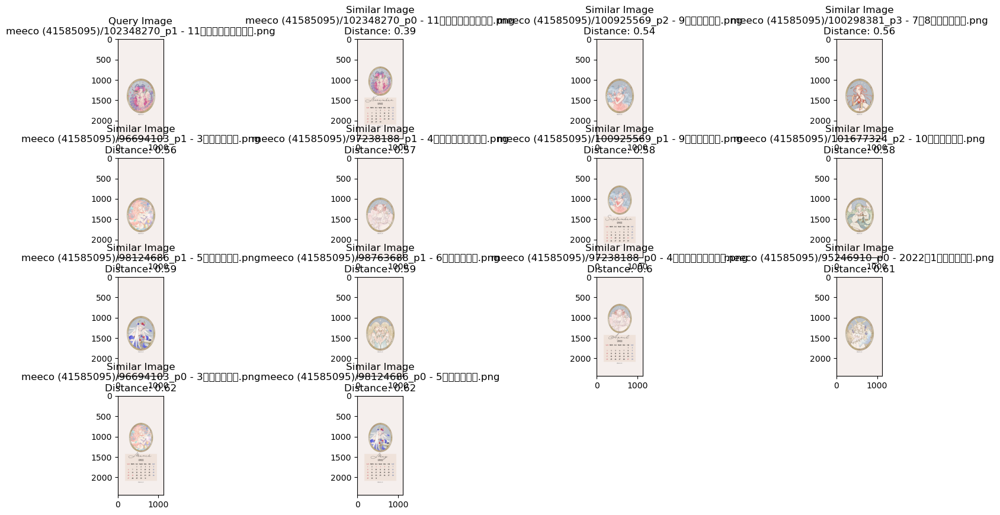

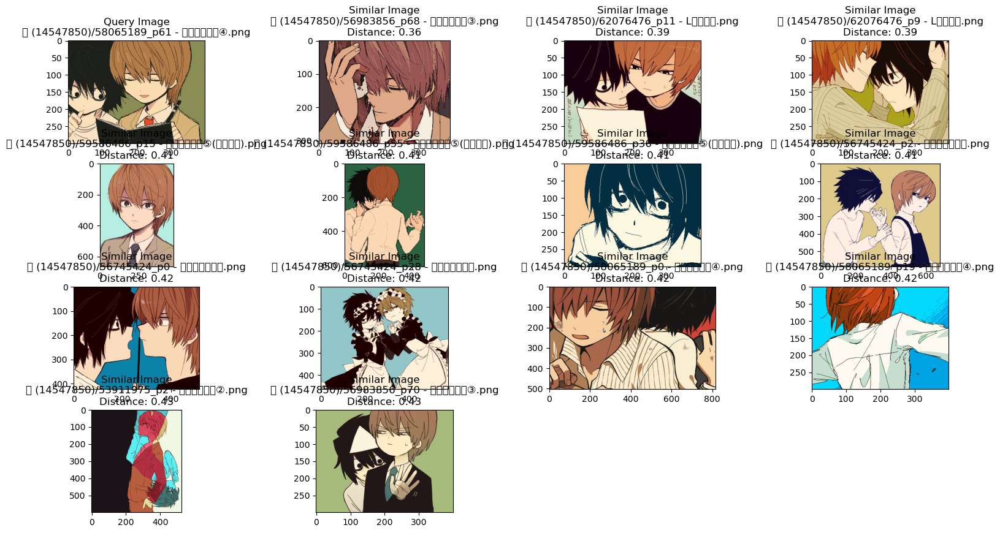

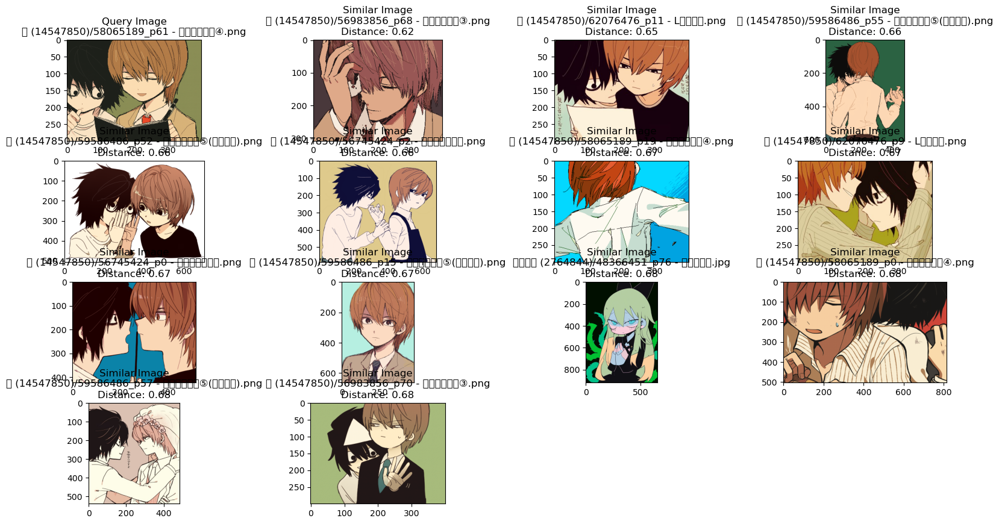

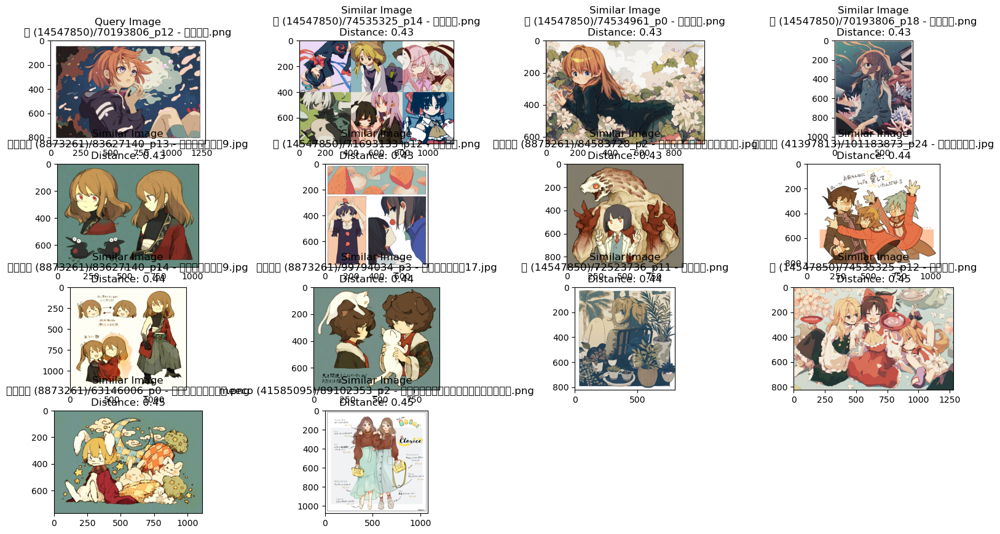

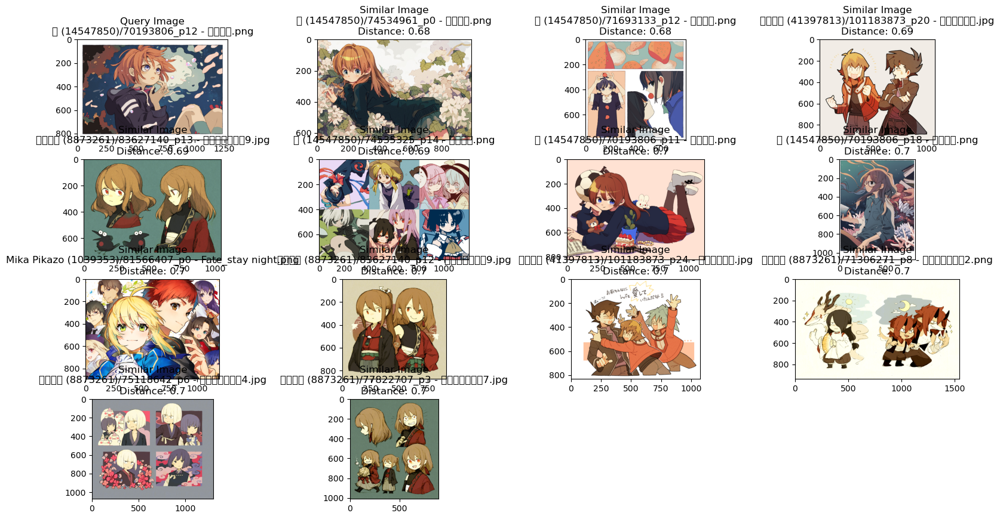

KeyboardInterrupt: 

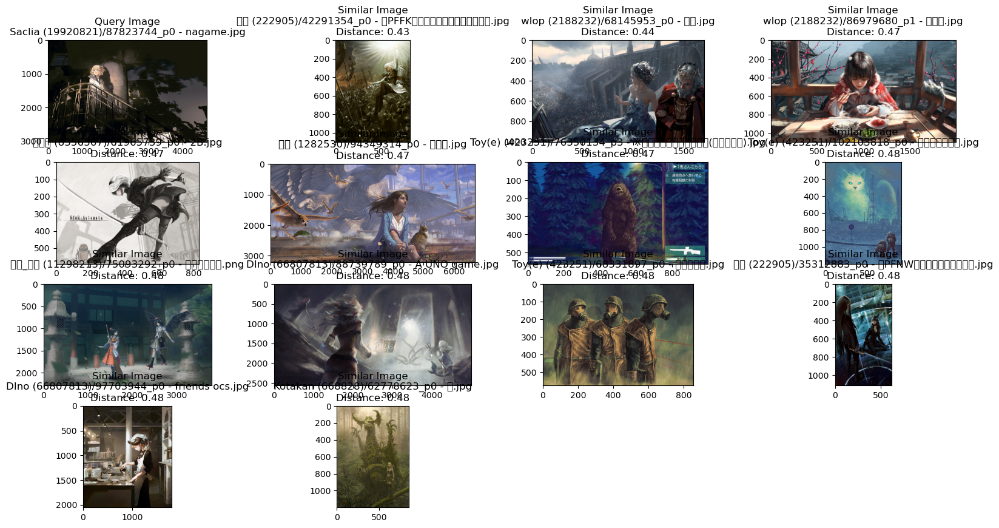

In [53]:
if CALCULATE_NEAREST_NEIGHBOURS:
    for i in range(15):
        random_image_index = random.randint(0, num_images)
        print(random_image_index)

        distances, indices = pcaneighbors.kneighbors(
            [feature_list_compressed[random_image_index]])
        # Don't take the first closest image as it will be the same image
        similar_image_paths = [filenames_baseline[random_image_index]] + \
            [filenames_baseline[indices[0][i]] for i in range(1, 4)]
        print("Nearest neighbours with PCA")
        plot_images(similar_image_paths, distances[0])
        plt.show()

        distances, indices = neighbors.kneighbors(
            [feature_list_baseline[random_image_index]])
        # Don't take the first closest image as it will be the same image
        similar_image_paths = [filenames_baseline[random_image_index]] + \
            [filenames_baseline[indices[0][i]] for i in range(1, 4)]
        print("Nearest neighbours without PCA")
        plot_images(similar_image_paths, distances[0])
        plt.show()

In [51]:
from sklearn.metrics import ndcg_score

def inferenceModelA(image_id, k=5):
    neighbors = NearestNeighbors(n_neighbors=k,
                             algorithm='brute',
                             metric='cosine').fit(feature_list_baseline)

    distances, indices = neighbors.kneighbors([feature_list_baseline[image_id]])

    # similar_image_paths = [filenames_baseline[indices[0][i]] for i in range(len(indices[0]))]

    similar_image_paths = [os.path.join("\\".join(root_dir.split('/')), *filenames_baseline[indices[0][i]].split('\\')[1:]) for i in range(len(indices[0]))]
    return indices, distances, similar_image_paths

def inferenceModelB(image_id, k=7):
    # concatenated = np.concatenate((np.matrix(feature_list_baseline), np.matrix(feature_list_gen2)), axis=1)

    neighbors = NearestNeighbors(n_neighbors=k,
                             algorithm='brute',
                             metric='cosine').fit(feature_list_baseline)

    distances, indices = neighbors.kneighbors([feature_list_baseline[image_id]])

    similar_image_paths = [os.path.join("\\".join(root_dir.split('/')), *filenames_baseline[indices[0][i]].split('\\')[1:]) for i in range(len(indices[0]))]
    return indices, distances, similar_image_paths

In [54]:
def display_query_image(filename):
    image = mpimg.imread(filename)
    plt.figure(figsize=(4, 5))
    ax = plt.gca()
    ax.set_title("Query Image\n" + classname_filename(filename))
    plt.imshow(image)
    # plt.savefig('results/' + str(random.randint(0,10000))+'.jpg', format='jpg', dpi=200)

def display_images(image_names):
    images = []
    for filename in image_names:
        images.append(mpimg.imread(filename))

    plt.figure(figsize=(20, 35))    
    columns = 3

    for i, image in enumerate(images):
        ax = plt.subplot(len(images) // columns + 1, columns, i + 1)
        ax.set_aspect('equal')
        # ax.set_title(classname_filename(image_names[i]))
        ax.set_title(str(i+1))
        plt.imshow(image)
        # plt.savefig('results/' + str(random.randint(0,10000))+'.jpg', format='jpg', dpi=200)

In [47]:
'/'.join(filenames_baseline[0].split('\\')[1:])

'0G-anorucmod (18597337)/100698482_p0 - study.png'

In [ ]:
random.seed(623)

precision_at_K_A = []
precision_at_K_B = []
ndcg_A = []
ndcg_B = []

for i in range(10):
    random_image_index = random.randint(0, num_images)
    print("\n", random_image_index)
    
    f_name_new = os.path.join("\\".join(root_dir.split('/')), *filenames_baseline[random_image_index].split('\\')[1:])
    display_query_image(f_name_new)
    plt.show()

    # %timeit inferenceModelA(random_image_index)
    indicesA, distancesA, similar_image_pathsA = inferenceModelA(random_image_index)

    indexB = {}
    for i, item in enumerate(filenames_gen2):
        item = '/'.join(item.split('/')[-2:])
        indexB[item] = i

    # indicesB, distancesB, similar_image_pathsB = inferenceModelB(indexB['/'.join(filenames_baseline[random_image_index].split('\\')[1:])])
    indicesB, distancesB, similar_image_pathsB = inferenceModelB(random_image_index)    

    index_mapA = {}
    index_mapB = {}

    for i, d, s in zip(indicesA[0], distancesA[0], similar_image_pathsA):
        index_mapA[i] = d, s

    for i, d, s in zip(indicesB[0], distancesB[0], similar_image_pathsB):
        index_mapB[i] = d, s

    merged_indices = set(np.append(indicesA[0], indicesB[0]))
    merged_indices.add(random_image_index)
    merged_indices.remove(random_image_index)
    merged_indices = list(merged_indices)

    random.shuffle(merged_indices)
    images = [index_mapA[i][1] if i in index_mapA else index_mapB[i][1] for i in merged_indices]

    display_images(images)
    plt.show()

    print("Enter rankings (space-separated):")
    user_rankings = list(map(int, input().split()))
    image_indices = [x-1 for x in user_rankings]

    scores_A = [10*(1-x) for x in distancesA[0]]
    scores_B = [10*(1-x) for x in distancesB[0]]
    true_relevance_A = [0] * len(scores_A)
    true_relevance_B = [0] * len(scores_B)

    A_indices = []
    B_indices = []

    for i, image_index in enumerate(image_indices):
        if images[image_index] in similar_image_pathsA:
            index = similar_image_pathsA.index(images[image_index])
            true_relevance_A[index] = (10-i)
            A_indices.append(image_index+1)

        if images[image_index] in similar_image_pathsB:
            index = similar_image_pathsB.index(images[image_index])
            true_relevance_B[index] = (10-i)
            B_indices.append(image_index+1)

    precision_at_K_A.append([])
    precision_at_K_B.append([])

    nCorrect = 0
    nTotal = 0
    for i, true_relevance in enumerate(true_relevance_A):
        nTotal += 1
        if true_relevance == 0:
            precision_at_K_A[-1].append(0)
        else:
            nCorrect += 1
            precision_at_K_A[-1].append(nCorrect/nTotal)

    nCorrect = 0
    nTotal = 0
    for i, true_relevance in enumerate(true_relevance_B):
        nTotal += 1
        if true_relevance == 0:
            precision_at_K_B[-1].append(0)
        else:
            nCorrect += 1
            precision_at_K_B[-1].append(nCorrect/nTotal)

    print("Images from A:", A_indices)
    print("Images from B:", B_indices)
    print("True Relevance A:", true_relevance_A)
    # print("Scores A:", scores_A)
    print("True Relevance B:", true_relevance_B)
    # print("Scores B:", scores_B)
    ndcg_A.append(ndcg_score(np.asarray([true_relevance_A]), np.asarray([scores_A])))
    ndcg_B.append(ndcg_score(np.asarray([true_relevance_B]), np.asarray([scores_B])))
    print("NDCG Score of A:", ndcg_A[-1])
    print("NDCG Score of B:", ndcg_B[-1])
    print("MAP@k of A:", np.average(precision_at_K_A[-1]))
    print("MAP@k of B:", np.average(precision_at_K_B[-1]))

<Figure size 20x3000 with 0 Axes>

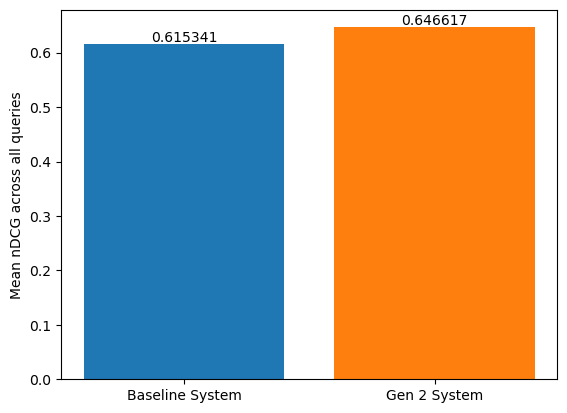

In [59]:
indexes = ["Baseline System", "Gen 2 System"]
values = [np.average(ndcg_A), np.average(ndcg_B)]
plt.figure(figsize=(0.2, 30))
fig, ax = plt.subplots()
bars1 = ax.bar(indexes[:1], values[:1])
ax.bar_label(bars1)
bars2 = ax.bar(indexes[1:], values[1:])
ax.bar_label(bars2)
ax.set_ylabel("Mean nDCG across all queries")
plt.show()

<Figure size 20x3000 with 0 Axes>

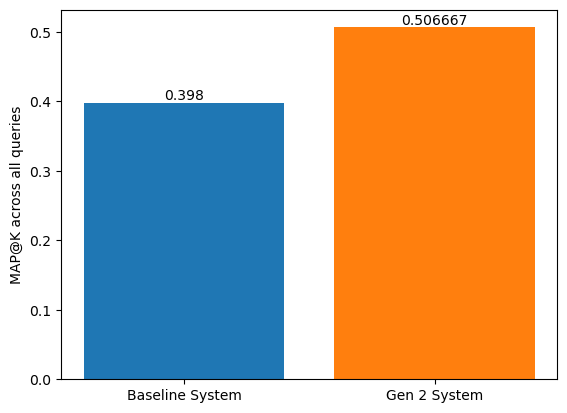

In [60]:
indexes = ["Baseline System", "Gen 2 System"]
values = [np.average([np.average(x) for x in precision_at_K_A]),
          np.average([np.average(x) for x in precision_at_K_B])]
plt.figure(figsize=(0.2, 30))
fig, ax = plt.subplots()
bars1 = ax.bar(indexes[:1], values[:1])
ax.bar_label(bars1)
bars2 = ax.bar(indexes[1:], values[1:])
ax.bar_label(bars2)
ax.set_ylabel("MAP@K across all queries")
plt.show()